In [1]:
import concord as ccd
import scanpy as sc
import torch
import warnings
from pathlib import Path
import time
warnings.filterwarnings('ignore')

data_dir = Path('../data/drosophila_bordercell/') # Replace with your data directory
data_path = data_dir / "dros_ec_all.h5ad"
adata = sc.read(data_path)

In [2]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.4,seurat_clusters,Dataset
d1_AAAGCTGCTAGG,dros_ec,95345.0,4978,6.226860,3,3,d1
d1_CGCCGCTCCACG,dros_ec,68709.0,3860,5.766348,1,1,d1
d1_CCGGTGTGATTC,dros_ec,66386.0,3617,4.705811,4,4,d1
d1_TCTCCGTCCCAG,dros_ec,50964.0,3438,6.528138,2,2,d1
d1_TAGCTTACCTCG,dros_ec,37831.0,2525,5.469060,4,4,d1
...,...,...,...,...,...,...,...
f2_TTGGAACAGAAA,dros_ec,1231.0,366,50.852965,5,5,f2
f2_AGTTAGCCTGTG,dros_ec,2104.0,447,22.243346,0,0,f2
f2_GAGTAAATTGTG,dros_ec,841.0,292,3.567182,0,0,f2
f2_AGCAGCTGCAAC,dros_ec,792.0,314,9.217172,0,0,f2


In [3]:
proj_name = "concord_bordercell"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/" # Replace with your save directory if needed
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') # Replace with your device, for example, 'mps' for Apple silicon
file_suffix = f"{time.strftime('%b%d-%H%M')}" # Replace with your file suffix if needed
seed = 0

In [4]:
adata.X = adata.layers["counts"].copy()

In [5]:
adata.shape

(4793, 13881)

In [7]:
feature_list = ccd.ul.select_features(adata, n_top_features=5000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'batch_size':64, # Batch size for training, adjust as needed
        'latent_dim': 300, # Latent dimension size, adjust as needed
        'encoder_dims':[1000], # Encoder dimensions, recommended to be larger than latent_dim
        'use_decoder': False, # Whether to use a decoder, set to True if you want to use the decoder
        'decoder_dims':[1000], # Decoder dimensions, ignored if use_decoder is False
        'augmentation_mask_prob': 0.4, # Probability of masking features, recommended to be between 0.2 and 0.5
        'clr_temperature': 0.5, # Temperature for contrastive loss, recommended to be between 0.1 and 0.5
        'p_intra_knn': 0.3, # Probability of intra-neighborhood sampling, must be less than 0.5
        'sampler_knn': 300, # Size of neighbohood for intra-neighborhood sampling
        'p_intra_domain': .95, # Enrichment probability for intra-domain sampling, recommended to be between 0.85 and 1.0, note the lower the value, the more dataset-specific information (may contain batch effects) is preserved
        'n_epochs': 15, # Number of epochs for training, adjust as needed
        'domain_key': None, # Key in adata.obs for batch labels
        'verbose': True, # Verbosity level, set to True for more detailed output
        'inplace': False, # Whether to modify adata in place, if not you need to copy the obsm out of ccd.adata
        'seed': seed, # random seed for reproducibility
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

In [8]:
output_key = 'Concord'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.encode_adata(input_layer_key='X_log1p', output_key=output_key) # Result saved to ccd.adata.obsm[output_key]
adata.obsm = cur_ccd.adata.obsm # If not inplace, copy the obsm out of ccd.adata

Concord - WARNING - domain/batch information not found, all samples will be treated as from single domain/batch.
Concord - INFO - Encoder input dim: 5000
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 5303908
Concord - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord - INFO - PCA completed.


FAISS not found. Using sklearn for k-NN computation.
You specified p_intra_domain as 0.95 but you only have one domain. Resetting p_intra_domain to 1.0.


p_intra_knn: 0.3
Concord - INFO - Starting epoch 1/15
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 0 Training: 74it [00:01, 42.05it/s, loss=3.63]

Concord - INFO - Epoch   0 | Train Loss: 3.94, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.94, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/15
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 1 Training: 100%|██████████| 74/74 [00:01<00:00, 43.28it/s, loss=3.53]

Concord - INFO - Epoch   1 | Train Loss: 3.59, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.59, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/15
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 2 Training: 100%|██████████| 74/74 [00:01<00:00, 41.80it/s, loss=3.5] 

Concord - INFO - Epoch   2 | Train Loss: 3.54, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.54, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/15
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 3 Training: 100%|██████████| 74/74 [00:01<00:00, 42.48it/s, loss=3.45]

Concord - INFO - Epoch   3 | Train Loss: 3.51, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.51, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/15


Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 4 Training: 100%|██████████| 74/74 [00:01<00:00, 43.35it/s, loss=3.46]

Concord - INFO - Epoch   4 | Train Loss: 3.49, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.49, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/15


Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 5 Training: 100%|██████████| 74/74 [00:01<00:00, 43.27it/s, loss=3.46]

Concord - INFO - Epoch   5 | Train Loss: 3.45, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.45, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/15
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 6 Training: 100%|██████████| 74/74 [00:01<00:00, 43.52it/s, loss=3.41]

Concord - INFO - Epoch   6 | Train Loss: 3.44, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.44, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/15


Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 7 Training: 100%|██████████| 74/74 [00:01<00:00, 41.92it/s, loss=3.42]

Concord - INFO - Epoch   7 | Train Loss: 3.44, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.44, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/15
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 8 Training: 100%|██████████| 74/74 [00:01<00:00, 41.23it/s, loss=3.42]

Concord - INFO - Epoch   8 | Train Loss: 3.43, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.43, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/15
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 9 Training: 100%|██████████| 74/74 [00:01<00:00, 42.35it/s, loss=3.43]

Concord - INFO - Epoch   9 | Train Loss: 3.42, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.42, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 11/15
Concord - INFO - Processing chunk 1/1 for epoch 11
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 10 Training: 100%|██████████| 74/74 [00:01<00:00, 42.40it/s, loss=3.42]

Concord - INFO - Epoch  10 | Train Loss: 3.40, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.40, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 12/15
Concord - INFO - Processing chunk 1/1 for epoch 12
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 11 Training: 100%|██████████| 74/74 [00:01<00:00, 42.48it/s, loss=3.33]

Concord - INFO - Epoch  11 | Train Loss: 3.39, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.39, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 13/15
Concord - INFO - Processing chunk 1/1 for epoch 13
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 12 Training: 100%|██████████| 74/74 [00:01<00:00, 40.42it/s, loss=3.37]

Concord - INFO - Epoch  12 | Train Loss: 3.39, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.39, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 14/15
Concord - INFO - Processing chunk 1/1 for epoch 14
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 13 Training: 100%|██████████| 74/74 [00:01<00:00, 39.85it/s, loss=3.38]

Concord - INFO - Epoch  13 | Train Loss: 3.39, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.39, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 15/15
Concord - INFO - Processing chunk 1/1 for epoch 15
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 14 Training: 100%|██████████| 74/74 [00:01<00:00, 43.49it/s, loss=3.36]

Concord - INFO - Epoch  14 | Train Loss: 3.36, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.36, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/concord_bordercell-Apr22/final_model_Apr22-1312.pt
Concord - INFO - Final model saved at: ../save/concord_bordercell-Apr22/final_model_Apr22-1312.pt; Configuration saved at: ../save/concord_bordercell-Apr22/config_Apr22-1312.json.
Concord - INFO - Predicting for chunk 1/1


In [9]:
adata.obsm['Seurat_UMAP'] = adata.obsm['umap'] # Copy the PCA results to adata.obsm['Seurat'] for comparison

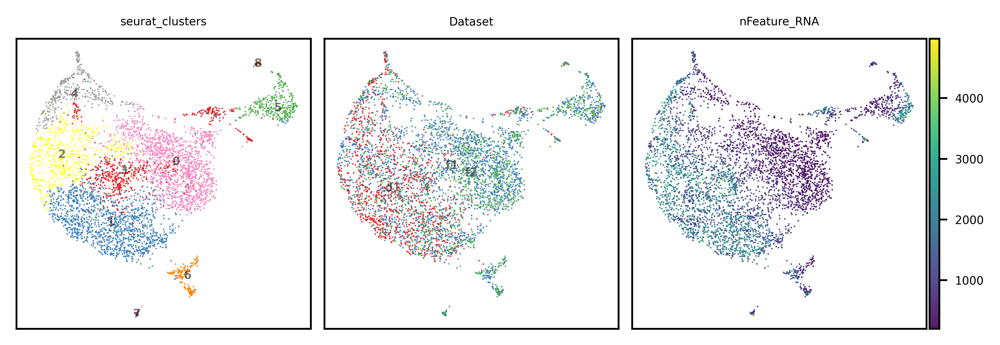

In [10]:
basis = 'Seurat'
#ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['seurat_clusters', 'Dataset', "nFeature_RNA"]
#pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(6,2), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = None,
    save_path=save_dir / f"{show_basis}_{file_suffix}.pdf"
)

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


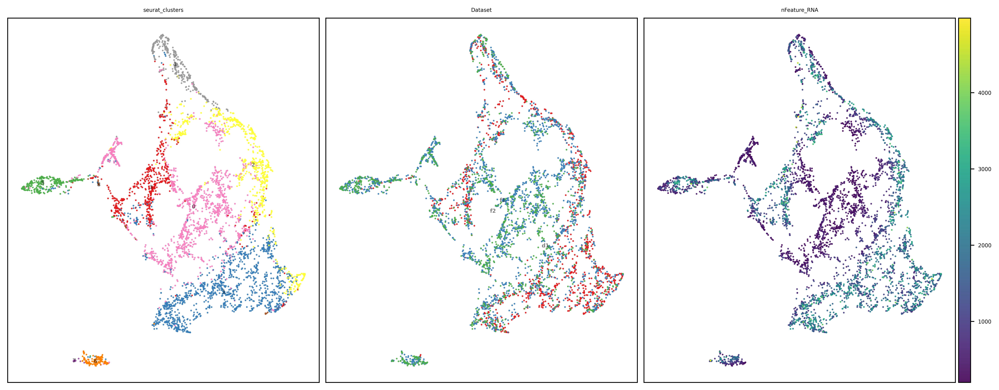

In [11]:
basis = 'Concord'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['seurat_clusters', 'Dataset', "nFeature_RNA"]
#pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=600, ncols=3, font_size=5, point_size=10, legend_loc='on data', 
    pal = None,
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [75]:
feature_list = ccd.ul.select_features(adata, n_top_features=5000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'batch_size':64, # Batch size for training, adjust as needed
        'latent_dim': 100, # Latent dimension size, adjust as needed
        'encoder_dims':[1000], # Encoder dimensions, recommended to be larger than latent_dim
        'use_decoder': False, # Whether to use a decoder, set to True if you want to use the decoder
        'decoder_dims':[1000], # Decoder dimensions, ignored if use_decoder is False
        'augmentation_mask_prob': 0.4, # Probability of masking features, recommended to be between 0.2 and 0.5
        'clr_temperature': 0.3, # Temperature for contrastive loss, recommended to be between 0.1 and 0.5
        'p_intra_knn': 0.2, # Probability of intra-neighborhood sampling, must be less than 0.5
        'sampler_knn': 300, # Size of neighbohood for intra-neighborhood sampling
        'p_intra_domain': .95, # Enrichment probability for intra-domain sampling, recommended to be between 0.85 and 1.0, note the lower the value, the more dataset-specific information (may contain batch effects) is preserved
        'n_epochs': 15, # Number of epochs for training, adjust as needed
        'domain_key': 'Dataset', # Key in adata.obs for batch labels
        'verbose': True, # Verbosity level, set to True for more detailed output
        'inplace': False, # Whether to modify adata in place, if not you need to copy the obsm out of ccd.adata
        'seed': seed, # random seed for reproducibility
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

In [76]:
output_key = 'Concord_int'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.encode_adata(input_layer_key='X_log1p', output_key=output_key) # Result saved to ccd.adata.obsm[output_key]
adata.obsm = cur_ccd.adata.obsm # If not inplace, copy the obsm out of ccd.adata

Concord - INFO - Column 'Dataset' is already of type: category
Concord - INFO - Unused levels dropped for column 'Dataset'.
Concord - INFO - Encoder input dim: 5000
Concord - INFO - Model loaded to device: cpu
Concord - INFO - Total number of parameters: 5103324


FAISS not found. Using sklearn for k-NN computation.


p_intra_knn: 0.2
Concord - INFO - Starting epoch 1/15
Concord - INFO - Processing chunk 1/1 for epoch 1
Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 0 Training: 73it [00:01, 48.75it/s, loss=3.13]

Concord - INFO - Epoch   0 | Train Loss: 3.61, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.61, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/15
Concord - INFO - Processing chunk 1/1 for epoch 2


Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 1 Training: 100%|██████████| 73/73 [00:01<00:00, 40.09it/s, loss=2.93]

Concord - INFO - Epoch   1 | Train Loss: 3.10, MSE: 0.00, CLASS: 0.00, CONTRAST: 3.10, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/15
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 2 Training: 100%|██████████| 73/73 [00:01<00:00, 45.25it/s, loss=2.9] 

Concord - INFO - Epoch   2 | Train Loss: 2.93, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.93, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/15
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 3 Training: 100%|██████████| 73/73 [00:01<00:00, 44.06it/s, loss=2.75]

Concord - INFO - Epoch   3 | Train Loss: 2.86, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.86, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/15
Concord - INFO - Processing chunk 1/1 for epoch 5


Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 4 Training: 100%|██████████| 73/73 [00:01<00:00, 42.47it/s, loss=2.86]

Concord - INFO - Epoch   4 | Train Loss: 2.78, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.78, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 6/15
Concord - INFO - Processing chunk 1/1 for epoch 6
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 5 Training: 100%|██████████| 73/73 [00:01<00:00, 41.91it/s, loss=2.82]

Concord - INFO - Epoch   5 | Train Loss: 2.76, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.76, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 7/15
Concord - INFO - Processing chunk 1/1 for epoch 7
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 6 Training: 100%|██████████| 73/73 [00:01<00:00, 41.90it/s, loss=2.7] 

Concord - INFO - Epoch   6 | Train Loss: 2.73, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.73, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 8/15


Concord - INFO - Processing chunk 1/1 for epoch 8
Concord - INFO - Number of samples in train_dataloader: 4793


Epoch 7 Training: 100%|██████████| 73/73 [00:01<00:00, 42.56it/s, loss=2.76]

Concord - INFO - Epoch   7 | Train Loss: 2.68, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.68, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 9/15
Concord - INFO - Processing chunk 1/1 for epoch 9
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 8 Training: 100%|██████████| 73/73 [00:01<00:00, 44.38it/s, loss=2.63]

Concord - INFO - Epoch   8 | Train Loss: 2.68, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.68, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 10/15
Concord - INFO - Processing chunk 1/1 for epoch 10
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 9 Training: 100%|██████████| 73/73 [00:01<00:00, 41.90it/s, loss=2.84]

Concord - INFO - Epoch   9 | Train Loss: 2.65, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.65, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 11/15
Concord - INFO - Processing chunk 1/1 for epoch 11
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 10 Training: 100%|██████████| 73/73 [00:01<00:00, 42.28it/s, loss=2.57]

Concord - INFO - Epoch  10 | Train Loss: 2.64, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.64, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 12/15
Concord - INFO - Processing chunk 1/1 for epoch 12
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 11 Training: 100%|██████████| 73/73 [00:01<00:00, 41.18it/s, loss=2.51]

Concord - INFO - Epoch  11 | Train Loss: 2.62, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.62, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 13/15
Concord - INFO - Processing chunk 1/1 for epoch 13
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 12 Training: 100%|██████████| 73/73 [00:01<00:00, 42.00it/s, loss=2.58]

Concord - INFO - Epoch  12 | Train Loss: 2.61, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.61, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 14/15
Concord - INFO - Processing chunk 1/1 for epoch 14
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 13 Training: 100%|██████████| 73/73 [00:01<00:00, 42.61it/s, loss=2.55]

Concord - INFO - Epoch  13 | Train Loss: 2.60, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.60, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 15/15
Concord - INFO - Processing chunk 1/1 for epoch 15
Concord - INFO - Number of samples in train_dataloader: 4793



Epoch 14 Training: 100%|██████████| 73/73 [00:01<00:00, 42.63it/s, loss=2.66]

Concord - INFO - Epoch  14 | Train Loss: 2.58, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.58, IMPORTANCE: 0.00


Concord - INFO - Model saved to ../save/concord_bordercell-Apr22/final_model_Apr22-1455.pt
Concord - INFO - Final model saved at: ../save/concord_bordercell-Apr22/final_model_Apr22-1455.pt; Configuration saved at: ../save/concord_bordercell-Apr22/config_Apr22-1455.json.
Concord - INFO - Predicting for chunk 1/1


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_int_UMAP']


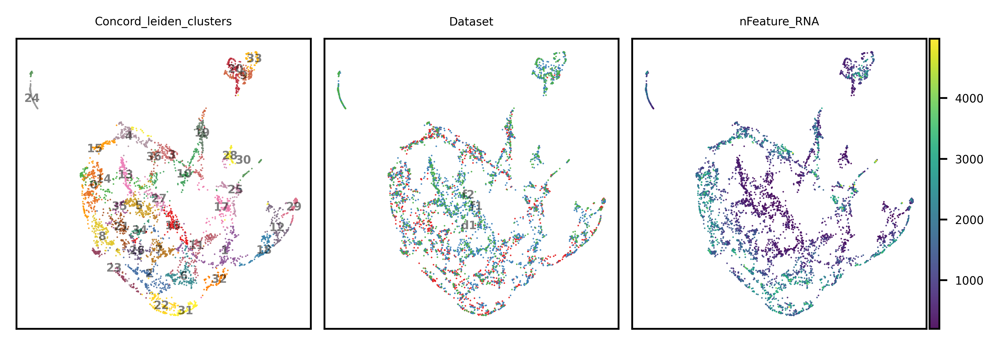

In [110]:
basis = 'Concord_int'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.05, metric='cosine', random_state=2)
show_basis = basis + '_UMAP'
# Leiden clustering on Concord_int
import scanpy as sc
import numpy as np
import pandas as pd
sc.pp.neighbors(adata, use_rep='Concord_int', n_neighbors=10, knn=True)
sc.tl.leiden(adata, resolution=1.5, key_added='Concord_leiden_clusters', random_state=seed)
show_cols = ['Concord_leiden_clusters', 'Dataset', "nFeature_RNA"]
#pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(6,2), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = None,
    save_path=save_dir / f"{show_basis}_{file_suffix}.pdf"
)

In [111]:
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='cosine', random_state=seed)
import plotly.io as pio
pio.renderers.default = 'notebook'
for col in show_cols:
    show_basis = f'{basis}_UMAP_3D'
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = None,
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=2, opacity=0.8, width=1500, height=1000
        )

Concord - INFO - UMAP embedding stored in adata.obsm['Concord_int_UMAP_3D']


In [112]:
# save results
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, save_dir / f"obsm_{proj_name}_{file_suffix}.h5")
adata.write_h5ad(data_dir / f"{proj_name}_{file_suffix}.h5ad")

In [113]:
ccd.ul.anndata_to_viscello(adata, data_dir / f"cello_{proj_name}_{file_suffix}", project_name = proj_name, organism='dme')

Concord - INFO - Normalized expression data (adata.layers['X_log1p']) not found. Renormalize and log transforming.
VisCello project created at ../data/drosophila_bordercell/cello_concord_bordercell_Apr22-1311
